In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
#EDA
from collections import Counter
import pandas_profiling as pp
from sklearn.preprocessing import StandardScaler
# data splitting
from sklearn.model_selection import train_test_split
# data modeling
from sklearn.metrics import confusion_matrix,accuracy_score,roc_curve,classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
#ensembling
from mlxtend.classifier import StackingCVClassifier

In [2]:
data=pd.read_csv('C:/Users/pabitrap/liver and heart dataset.csv')
data

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,...,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,65,0,0.7,0.1,187,16,18,6.8,3.3,0.90,...,212,0,1,168,0,1.0,2,2,3,0
1,62,1,10.9,5.5,699,64,100,7.5,3.2,0.74,...,203,1,0,155,1,3.1,0,0,3,0
2,62,1,7.3,4.1,490,60,68,7.0,3.3,0.89,...,174,0,1,125,1,2.6,0,0,3,0
3,58,1,1.0,0.4,182,14,20,6.8,3.4,1.00,...,203,0,1,161,0,0.0,2,1,3,0
4,72,1,3.9,2.0,195,27,59,7.3,2.4,0.40,...,294,1,1,106,0,1.9,1,3,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
578,60,1,0.5,0.1,500,20,34,5.9,1.6,0.37,...,394,0,0,157,0,1.2,1,0,2,1
579,40,1,0.6,0.1,98,35,31,6.0,3.2,1.10,...,218,0,1,105,0,2.0,1,1,3,0
580,52,1,0.8,0.2,245,48,49,6.4,3.2,1.00,...,197,1,1,156,0,0.0,2,0,3,1
581,31,1,1.3,0.5,184,29,32,6.8,3.4,1.00,...,235,0,0,180,0,0.0,2,0,2,1


In [3]:
data.describe()

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,...,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
count,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,579.000000,...,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000
mean,44.746141,0.756432,3.298799,1.486106,290.576329,80.713551,109.910806,6.483190,3.141852,0.947064,...,247.188679,0.157804,0.487136,150.288165,0.320755,1.033619,1.401372,0.759863,2.300172,0.536878
std,16.189833,0.429603,6.209522,2.808498,242.937989,182.620356,288.918529,1.085451,0.795519,0.319592,...,54.548211,0.364871,0.520464,23.074569,0.467168,1.185234,0.623259,1.058739,0.609870,0.499066
min,4.000000,0.000000,0.400000,0.100000,63.000000,10.000000,10.000000,2.700000,0.900000,0.300000,...,126.000000,0.000000,0.000000,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,33.000000,1.000000,0.800000,0.200000,175.500000,23.000000,25.000000,5.800000,2.600000,0.700000,...,209.500000,0.000000,0.000000,138.000000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000
50%,45.000000,1.000000,1.000000,0.300000,208.000000,35.000000,42.000000,6.600000,3.100000,0.930000,...,243.000000,0.000000,0.000000,153.000000,0.000000,0.800000,1.000000,0.000000,2.000000,1.000000
75%,58.000000,1.000000,2.600000,1.300000,298.000000,60.500000,87.000000,7.200000,3.800000,1.100000,...,281.500000,0.000000,1.000000,167.500000,1.000000,1.600000,2.000000,1.000000,3.000000,1.000000
max,90.000000,1.000000,75.000000,19.700000,2110.000000,2000.000000,4929.000000,9.600000,5.500000,2.800000,...,564.000000,1.000000,2.000000,202.000000,1.000000,6.200000,2.000000,4.000000,3.000000,1.000000


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 583 entries, 0 to 582
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Age                         583 non-null    int64  
 1   Gender                      583 non-null    int64  
 2   Total_Bilirubin             583 non-null    float64
 3   Direct_Bilirubin            583 non-null    float64
 4   Alkaline_Phosphotase        583 non-null    int64  
 5   Alamine_Aminotransferase    583 non-null    int64  
 6   Aspartate_Aminotransferase  583 non-null    int64  
 7   Total_Protiens              583 non-null    float64
 8   Albumin                     583 non-null    float64
 9   Albumin_and_Globulin_Ratio  579 non-null    float64
 10  cp                          583 non-null    int64  
 11  trestbps                    583 non-null    int64  
 12  chol                        583 non-null    int64  
 13  fbs                         583 non

In [5]:
data.shape

(583, 22)

In [6]:
data.isnull().sum()

Age                           0
Gender                        0
Total_Bilirubin               0
Direct_Bilirubin              0
Alkaline_Phosphotase          0
Alamine_Aminotransferase      0
Aspartate_Aminotransferase    0
Total_Protiens                0
Albumin                       0
Albumin_and_Globulin_Ratio    4
cp                            0
trestbps                      0
chol                          0
fbs                           0
restecg                       0
thalach                       0
exang                         0
oldpeak                       0
slope                         0
ca                            0
thal                          0
target                        0
dtype: int64

In [7]:
dta=data.dropna() 
dta

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,...,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,65,0,0.7,0.1,187,16,18,6.8,3.3,0.90,...,212,0,1,168,0,1.0,2,2,3,0
1,62,1,10.9,5.5,699,64,100,7.5,3.2,0.74,...,203,1,0,155,1,3.1,0,0,3,0
2,62,1,7.3,4.1,490,60,68,7.0,3.3,0.89,...,174,0,1,125,1,2.6,0,0,3,0
3,58,1,1.0,0.4,182,14,20,6.8,3.4,1.00,...,203,0,1,161,0,0.0,2,1,3,0
4,72,1,3.9,2.0,195,27,59,7.3,2.4,0.40,...,294,1,1,106,0,1.9,1,3,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
578,60,1,0.5,0.1,500,20,34,5.9,1.6,0.37,...,394,0,0,157,0,1.2,1,0,2,1
579,40,1,0.6,0.1,98,35,31,6.0,3.2,1.10,...,218,0,1,105,0,2.0,1,1,3,0
580,52,1,0.8,0.2,245,48,49,6.4,3.2,1.00,...,197,1,1,156,0,0.0,2,0,3,1
581,31,1,1.3,0.5,184,29,32,6.8,3.4,1.00,...,235,0,0,180,0,0.0,2,0,2,1


In [8]:
pp.ProfileReport(dta)

In [9]:
y = dta["target"]
X = dta.drop('target',axis=1)

In [10]:
X

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,...,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal
0,65,0,0.7,0.1,187,16,18,6.8,3.3,0.90,...,125,212,0,1,168,0,1.0,2,2,3
1,62,1,10.9,5.5,699,64,100,7.5,3.2,0.74,...,140,203,1,0,155,1,3.1,0,0,3
2,62,1,7.3,4.1,490,60,68,7.0,3.3,0.89,...,145,174,0,1,125,1,2.6,0,0,3
3,58,1,1.0,0.4,182,14,20,6.8,3.4,1.00,...,148,203,0,1,161,0,0.0,2,1,3
4,72,1,3.9,2.0,195,27,59,7.3,2.4,0.40,...,138,294,1,1,106,0,1.9,1,3,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
578,60,1,0.5,0.1,500,20,34,5.9,1.6,0.37,...,140,394,0,0,157,0,1.2,1,0,2
579,40,1,0.6,0.1,98,35,31,6.0,3.2,1.10,...,146,218,0,1,105,0,2.0,1,1,3
580,52,1,0.8,0.2,245,48,49,6.4,3.2,1.00,...,101,197,1,1,156,0,0.0,2,0,3
581,31,1,1.3,0.5,184,29,32,6.8,3.4,1.00,...,140,235,0,0,180,0,0.0,2,0,2


In [11]:
y

0      0
1      0
2      0
3      0
4      0
      ..
578    1
579    0
580    1
581    1
582    1
Name: target, Length: 579, dtype: int64

In [12]:
#FeatureScalling
#MinMaxScaler
import pandas,scipy,numpy
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler(feature_range=(0,1))
rescaledX=scaler.fit_transform(X)
rescaledX[0:5,:]

array([[0.70930233, 0.        , 0.00402145, 0.        , 0.06057645,
        0.00301508, 0.00162635, 0.5942029 , 0.52173913, 0.24      ,
        0.        , 0.29245283, 0.19634703, 0.        , 0.5       ,
        0.74045802, 0.        , 0.16129032, 1.        , 0.5       ,
        1.        ],
       [0.6744186 , 1.        , 0.14075067, 0.2755102 , 0.31069858,
        0.02713568, 0.0182964 , 0.69565217, 0.5       , 0.176     ,
        0.        , 0.43396226, 0.17579909, 1.        , 0.        ,
        0.64122137, 1.        , 0.5       , 0.        , 0.        ,
        1.        ],
       [0.6744186 , 1.        , 0.0924933 , 0.20408163, 0.20859795,
        0.02512563, 0.01179101, 0.62318841, 0.52173913, 0.236     ,
        0.        , 0.48113208, 0.10958904, 0.        , 0.5       ,
        0.41221374, 1.        , 0.41935484, 0.        , 0.        ,
        1.        ],
       [0.62790698, 1.        , 0.0080429 , 0.01530612, 0.05813385,
        0.00201005, 0.00203293, 0.5942029 , 0.5434782

In [13]:
#FeatureScalling
#Standardizing Data
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler().fit(X)
rescaledX=scaler.transform(X)
rescaledX[0:5,:]

array([[ 1.24740264, -1.77079482, -0.42031984, -0.49541415, -0.42887006,
        -0.35583241, -0.31911128,  0.29372174,  0.20344649, -0.14738974,
        -0.97721023, -0.39437528, -0.64231859, -0.43182799,  0.98276519,
         0.76269017, -0.68795526, -0.02549253,  0.95493521,  1.17666853,
         1.15773685],
       [ 1.06230624,  0.56471817,  1.21893587,  1.42351783,  1.67508295,
        -0.09357256, -0.03596174,  0.93965456,  0.07746198, -0.64846078,
        -0.97721023,  0.43435671, -0.80710405,  2.31573689, -0.9396032 ,
         0.19670684,  1.45358289,  1.74572853, -2.25032559, -0.71580669,
         1.15773685],
       [ 1.06230624,  0.56471817,  0.64037503,  0.92601694,  0.81624275,
        -0.11542755, -0.14645913,  0.47827397,  0.20344649, -0.17870668,
        -0.97721023,  0.71060071, -1.3380794 , -0.43182799,  0.98276519,
        -1.10940854,  1.45358289,  1.32400923, -2.25032559, -0.71580669,
         1.15773685],
       [ 0.81551105,  0.56471817, -0.37210644, -0.38880682

In [14]:
#FeatureScalling
#Normaliizing Data
from sklearn.preprocessing import Normalizer
scaler=Normalizer().fit(X)
normalizedX=scaler.transform(X)
normalizedX[0:5,:]

array([[1.81224891e-01, 0.00000000e+00, 1.95165267e-03, 2.78807524e-04,
        5.21370070e-01, 4.46092038e-02, 5.01853543e-02, 1.89589116e-02,
        9.20064829e-03, 2.50926772e-03, 0.00000000e+00, 3.48509405e-01,
        5.91071951e-01, 0.00000000e+00, 2.78807524e-03, 4.68396640e-01,
        0.00000000e+00, 2.78807524e-03, 5.57615048e-03, 5.57615048e-03,
        8.36422572e-03],
       [8.06070342e-02, 1.30011346e-03, 1.41712367e-02, 7.15062401e-03,
        9.08779305e-01, 8.32072612e-02, 1.30011346e-01, 9.75085092e-03,
        4.16036306e-03, 9.62083957e-04, 0.00000000e+00, 1.82015884e-01,
        2.63923031e-01, 1.30011346e-03, 0.00000000e+00, 2.01517586e-01,
        1.30011346e-03, 4.03035171e-03, 0.00000000e+00, 0.00000000e+00,
        3.90034037e-03],
       [1.09731326e-01, 1.76986010e-03, 1.29199788e-02, 7.25642643e-03,
        8.67231451e-01, 1.06191606e-01, 1.20350487e-01, 1.23890207e-02,
        5.84053834e-03, 1.57517549e-03, 0.00000000e+00, 2.56629715e-01,
        3.0795

In [15]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state = 0)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [16]:
print(y_test.unique())
Counter(y_train)

[1 0]


Counter({1: 242, 0: 221})

In [17]:
m1 = 'Logistic Regression'
lr = LogisticRegression()
model = lr.fit(X_train, y_train)
lr_predict = lr.predict(X_test)
lr_conf_matrix = confusion_matrix(y_test, lr_predict)
lr_acc_score = accuracy_score(y_test, lr_predict)
print("confussion matrix")
print(lr_conf_matrix)
print("\n")
print("Accuracy of Logistic Regression:",lr_acc_score*100,'\n')
print(classification_report(y_test,lr_predict))

confussion matrix
[[37  8]
 [ 8 63]]


Accuracy of Logistic Regression: 86.20689655172413 

              precision    recall  f1-score   support

           0       0.82      0.82      0.82        45
           1       0.89      0.89      0.89        71

    accuracy                           0.86       116
   macro avg       0.85      0.85      0.85       116
weighted avg       0.86      0.86      0.86       116



In [18]:
m2 = 'Naive Bayes'
nb = GaussianNB()
nb.fit(X_train,y_train)
nbpred = nb.predict(X_test)
nb_conf_matrix = confusion_matrix(y_test, nbpred)
nb_acc_score = accuracy_score(y_test, nbpred)
print("confussion matrix")
print(nb_conf_matrix)
print("\n")
print("Accuracy of Naive Bayes model:",nb_acc_score*100,'\n')
print(classification_report(y_test,nbpred))

confussion matrix
[[33 12]
 [ 8 63]]


Accuracy of Naive Bayes model: 82.75862068965517 

              precision    recall  f1-score   support

           0       0.80      0.73      0.77        45
           1       0.84      0.89      0.86        71

    accuracy                           0.83       116
   macro avg       0.82      0.81      0.82       116
weighted avg       0.83      0.83      0.83       116



In [19]:
m3 = 'Random Forest Classfier'
rf = RandomForestClassifier(n_estimators=20, random_state=2,max_depth=5)
rf.fit(X_train,y_train)
rf_predicted = rf.predict(X_test)
rf_conf_matrix = confusion_matrix(y_test, rf_predicted)
rf_acc_score = accuracy_score(y_test, rf_predicted)
print("confussion matrix")
print(rf_conf_matrix)
print("\n")
print("Accuracy of Random Forest:",rf_acc_score*100,'\n')
print(classification_report(y_test,rf_predicted))

confussion matrix
[[37  8]
 [ 4 67]]


Accuracy of Random Forest: 89.65517241379311 

              precision    recall  f1-score   support

           0       0.90      0.82      0.86        45
           1       0.89      0.94      0.92        71

    accuracy                           0.90       116
   macro avg       0.90      0.88      0.89       116
weighted avg       0.90      0.90      0.90       116



In [20]:
m4 = 'Extreme Gradient Boost'
xgb = XGBClassifier(learning_rate=0.01, n_estimators=25, max_depth=15,gamma=0.6, subsample=0.52,colsample_bytree=0.6,seed=27, 
                    reg_lambda=2, booster='dart', colsample_bylevel=0.6, colsample_bynode=0.5)
xgb.fit(X_train, y_train)
xgb_predicted = xgb.predict(X_test)
xgb_conf_matrix = confusion_matrix(y_test, xgb_predicted)
xgb_acc_score = accuracy_score(y_test, xgb_predicted)
print("confussion matrix")
print(xgb_conf_matrix)
print("\n")
print("Accuracy of Extreme Gradient Boost:",xgb_acc_score*100,'\n')
print(classification_report(y_test,xgb_predicted))

confussion matrix
[[38  7]
 [ 1 70]]


Accuracy of Extreme Gradient Boost: 93.10344827586206 

              precision    recall  f1-score   support

           0       0.97      0.84      0.90        45
           1       0.91      0.99      0.95        71

    accuracy                           0.93       116
   macro avg       0.94      0.92      0.93       116
weighted avg       0.93      0.93      0.93       116



In [21]:
m5 = 'K-NeighborsClassifier'
knn = KNeighborsClassifier(n_neighbors=10)
knn.fit(X_train, y_train)
knn_predicted = knn.predict(X_test)
knn_conf_matrix = confusion_matrix(y_test, knn_predicted)
knn_acc_score = accuracy_score(y_test, knn_predicted)
print("confussion matrix")
print(knn_conf_matrix)
print("\n")
print("Accuracy of K-NeighborsClassifier:",knn_acc_score*100,'\n')
print(classification_report(y_test,knn_predicted))

confussion matrix
[[40  5]
 [ 7 64]]


Accuracy of K-NeighborsClassifier: 89.65517241379311 

              precision    recall  f1-score   support

           0       0.85      0.89      0.87        45
           1       0.93      0.90      0.91        71

    accuracy                           0.90       116
   macro avg       0.89      0.90      0.89       116
weighted avg       0.90      0.90      0.90       116



In [22]:
m6 = 'DecisionTreeClassifier'
dt = DecisionTreeClassifier(criterion = 'entropy',random_state=0,max_depth = 6)
dt.fit(X_train, y_train)
dt_predicted = dt.predict(X_test)
dt_conf_matrix = confusion_matrix(y_test, dt_predicted)
dt_acc_score = accuracy_score(y_test, dt_predicted)
print("confussion matrix")
print(dt_conf_matrix)
print("\n")
print("Accuracy of DecisionTreeClassifier:",dt_acc_score*100,'\n')
print(classification_report(y_test,dt_predicted))

confussion matrix
[[37  8]
 [ 2 69]]


Accuracy of DecisionTreeClassifier: 91.37931034482759 

              precision    recall  f1-score   support

           0       0.95      0.82      0.88        45
           1       0.90      0.97      0.93        71

    accuracy                           0.91       116
   macro avg       0.92      0.90      0.91       116
weighted avg       0.92      0.91      0.91       116



In [23]:
m7 = 'Support Vector Classifier'
svc =  SVC(kernel='rbf', C=2)
svc.fit(X_train, y_train)
svc_predicted = svc.predict(X_test)
svc_conf_matrix = confusion_matrix(y_test, svc_predicted)
svc_acc_score = accuracy_score(y_test, svc_predicted)
print("confussion matrix")
print(svc_conf_matrix)
print("\n")
print("Accuracy of Support Vector Classifier:",svc_acc_score*100,'\n')
print(classification_report(y_test,svc_predicted))

confussion matrix
[[39  6]
 [ 5 66]]


Accuracy of Support Vector Classifier: 90.51724137931035 

              precision    recall  f1-score   support

           0       0.89      0.87      0.88        45
           1       0.92      0.93      0.92        71

    accuracy                           0.91       116
   macro avg       0.90      0.90      0.90       116
weighted avg       0.90      0.91      0.90       116



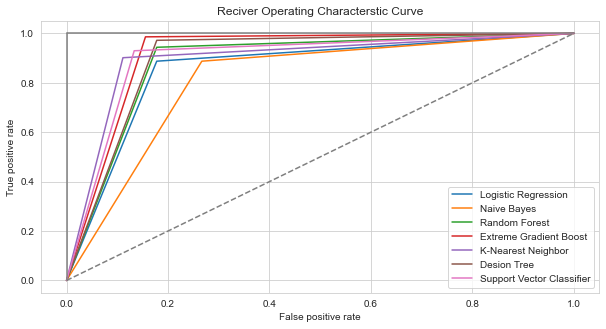

In [24]:
lr_false_positive_rate,lr_true_positive_rate,lr_threshold = roc_curve(y_test,lr_predict)
nb_false_positive_rate,nb_true_positive_rate,nb_threshold = roc_curve(y_test,nbpred)
rf_false_positive_rate,rf_true_positive_rate,rf_threshold = roc_curve(y_test,rf_predicted)                                                             
xgb_false_positive_rate,xgb_true_positive_rate,xgb_threshold = roc_curve(y_test,xgb_predicted)
knn_false_positive_rate,knn_true_positive_rate,knn_threshold = roc_curve(y_test,knn_predicted)
dt_false_positive_rate,dt_true_positive_rate,dt_threshold = roc_curve(y_test,dt_predicted)
svc_false_positive_rate,svc_true_positive_rate,svc_threshold = roc_curve(y_test,svc_predicted)


sns.set_style('whitegrid')
plt.figure(figsize=(10,5))
plt.title('Reciver Operating Characterstic Curve')
plt.plot(lr_false_positive_rate,lr_true_positive_rate,label='Logistic Regression')
plt.plot(nb_false_positive_rate,nb_true_positive_rate,label='Naive Bayes')
plt.plot(rf_false_positive_rate,rf_true_positive_rate,label='Random Forest')
plt.plot(xgb_false_positive_rate,xgb_true_positive_rate,label='Extreme Gradient Boost')
plt.plot(knn_false_positive_rate,knn_true_positive_rate,label='K-Nearest Neighbor')
plt.plot(dt_false_positive_rate,dt_true_positive_rate,label='Desion Tree')
plt.plot(svc_false_positive_rate,svc_true_positive_rate,label='Support Vector Classifier')
plt.plot([0,1],ls='--')
plt.plot([0,0],[1,0],c='.5')
plt.plot([1,1],c='.5')
plt.ylabel('True positive rate')
plt.xlabel('False positive rate')
plt.legend()
plt.show()

In [25]:
model_ev = pd.DataFrame({'Model': ['Logistic Regression','Naive Bayes','Random Forest','Extreme Gradient Boost',
                    'K-Nearest Neighbour','Decision Tree','Support Vector Machine'], 'Accuracy': [lr_acc_score*100,
                    nb_acc_score*100,rf_acc_score*100,xgb_acc_score*100,knn_acc_score*100,dt_acc_score*100,svc_acc_score*100]})
model_ev

,Model,Accuracy
0,Logistic Regression,86.206897
1,Naive Bayes,82.758621
2,Random Forest,89.655172
3,Extreme Gradient Boost,93.103448
4,K-Nearest Neighbour,89.655172
5,Decision Tree,91.379310
6,Support Vector Machine,90.517241


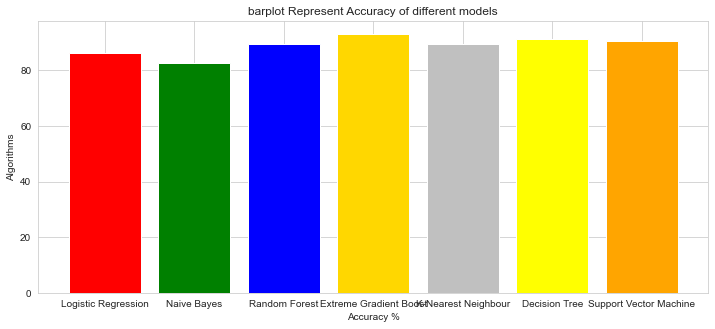

In [26]:
colors = ['red','green','blue','gold','silver','yellow','orange',]
plt.figure(figsize=(12,5))
plt.title("barplot Represent Accuracy of different models")
plt.xlabel("Accuracy %")
plt.ylabel("Algorithms")
plt.bar(model_ev['Model'],model_ev['Accuracy'],color = colors)
plt.show()

In [27]:
gd=StackingCVClassifier(classifiers=[xgb,knn,svc],meta_classifier= xgb,random_state=42)
gd.fit(X_train,y_train)
gd_predicted = gd.predict(X_test)
gd_conf_matrix = confusion_matrix(y_test, gd_predicted)
gd_acc_score = accuracy_score(y_test, gd_predicted)
print("confussion matrix")
print(gd_conf_matrix)
print("\n")
print("Accuracy of Gradient Boost :",gd_acc_score*100,'\n')
print(classification_report(y_test,gd_predicted))

confussion matrix
[[41  4]
 [ 2 69]]


Accuracy of Gradient Boost : 94.82758620689656 

              precision    recall  f1-score   support

           0       0.95      0.91      0.93        45
           1       0.95      0.97      0.96        71

    accuracy                           0.95       116
   macro avg       0.95      0.94      0.95       116
weighted avg       0.95      0.95      0.95       116

